## Imports

In [ ]:
!pip install "deeplake<4"
!pip install --upgrade transformers
!pip install nltk
!pip install torchvision

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 630.1/630.1 kB 3.8 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.4/77.4 kB 7.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.1/139.1 kB 13.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.2/16.2 MB 58.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 73.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 82.1/82.1 kB 8.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.6/12.6 MB 106.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 119.4/119.4 kB 13.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 14.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.8/56.8 kB 6.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 83.2/83.2 kB 9.1 MB/s eta 

In [ ]:
import torch
import torch.nn as nn

import deeplake
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from torchvision import transforms
from transformers import BertTokenizer, BertModel
import nltk
import random

from torch.utils.data import Dataset
from PIL import Image

/usr/local/lib/python3.10/dist-packages/deeplake/util/check_latest_version.py:32: UserWarning: A newer version of deeplake (4.1.0) is available. It's recommended that you update to the latest version using `pip install -U deeplake`.
  warnings.warn(


## Preprocessing Data, Tokenizing

Note: This section was also part of Demo 1

In [ ]:
ds = deeplake.load('hub://activeloop/flickr30k')

-

Opening dataset in read-only mode as you don't have write permissions.


-

This dataset can be visualized in Jupyter Notebook by ds.visualize() or at https://app.activeloop.ai/activeloop/flickr30k



\

hub://activeloop/flickr30k loaded successfully.



In [ ]:
images = ds.image
captions = ds.caption_0 ## NextSteps: currently only training on caption0, could include other set of captions
captions_1 = ds.caption_1
captions_2 = ds.caption_2
captions_3 = ds.caption_3
captions_4 = ds.caption_4

In [ ]:
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
bert_model = BertModel.from_pretrained('bert-base-uncased')

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

In [ ]:
caption_max_length = 20
vocab_size = len(tokenizer)

In [ ]:
def process_image(image):
  """
  Image transformation functions
  Resizes images to 224x224, converts to tensor, and normalizes
  The normalization parameters are mean, SD of of r, g, b pixel values
  """
  image_transform = transforms.Compose([
      transforms.Resize((224, 224)),
      transforms.ToTensor(),
      transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
  ])
  image = image.numpy()
  image = Image.fromarray(image)
  image = image_transform(image)
  return image


def process_caption(caption_text):
  """
  Tokenizes captions
  Returns tensor of tokenized captions, with a max length of 20,
  padding until this length, and truncating if the caption is longer
  The individual entries in the tensor are integers
  """

  tokenized = tokenizer(caption_text,
                        max_length=caption_max_length,
                        padding='max_length',
                        truncation=True,
                        return_tensors='pt')

  input_ids = tokenized['input_ids']
  attention_mask = tokenized['attention_mask']
  return input_ids

def untokenize(tokenized_text):
    """
    Untokenizes a tensor
    Takes a tensor of integers, and according to tokenizer, returns
    original words
    """
    return tokenizer.decode(tokenized_text, skip_special_tokens=True)


### Tests

Tokenizer Tests

In [ ]:
strings = ["hello world", "my dog went to the store", "the earth revolves around the sun",
           "I travelled to new york city and ate mexican and japanese food"]

def test_tokenizer(strings):
    """
    Function to test tokenizer, by tokenizing and untokenizing a string
    """
    for string in strings:
        # print ("input string: " + string)
        check = untokenize(process_caption(string)[0])
        # print ("output string: " + check)
        assert check.lower() == string.lower()
    print("All tests passed!")
test_tokenizer(strings)

All tests passed!


In [ ]:
tokenizer.tokenize("Hello I am Wendy")
tokenizer.encode("Hello I am Wendy", add_special_tokens = True)

[101, 7592, 1045, 2572, 12815, 102]

Data Processing Tests

In [ ]:
def test_process_image():
  test_img = ds.image[0]
  transformed_img = process_image(test_img)
  assert transformed_img.size(1) == 224 and transformed_img.size(2) == 224, "Image resizing failed."
  assert transformed_img.size(0) == 3, "Image channel mismatch."
  print("All tests passed!")

test_process_image()


All tests passed!


In [ ]:
def test_process_caption():
  caption = "A dog playing in the park."
  input_ids = process_caption(caption)
  assert input_ids.size(1) == 20, "Tokenized length incorrect."

  decoded_caption = untokenize(input_ids[0])
  assert decoded_caption.lower() == caption.lower(), "Caption untokenization incorrect."
  print("All tests passed!")
test_process_caption()

All tests passed!


## Dataset/Dataloader Creation

In [ ]:
class Flickr30kDataset(Dataset):
    def __init__(self, images, captions, image_transform=None, caption_transform = None):
      """
      Initializes dataset
      """
      self.images = images
      self.captions = captions
      self.image_transform = image_transform
      self.caption_transform = caption_transform

    def __len__(self):
      """
      Returns length of the dataset
      """
      return len(self.captions)

    def __getitem__(self, idx):
      """
      Returns a single item (image, and caption processed according to
      caption_transform) from the dataset
      """
      image = self.images[idx]
      image = self.image_transform(image)

      caption = self.captions[idx].numpy()[0]
      caption_embedding = self.caption_transform(caption)
      return image, caption_embedding


In [ ]:
from torch.utils.data import DataLoader, random_split

flickr_dataset = Flickr30kDataset(images, captions, image_transform=process_image, caption_transform=process_caption)

# 80% train, 10% val, 10% Test
train_size = int(0.8 * len(flickr_dataset))
val_size = int(0.1 * len(flickr_dataset))
test_size = len(flickr_dataset) - train_size - val_size

train_dataset, eval_dataset, test_dataset = random_split(flickr_dataset, [train_size, val_size, test_size])

batch_size = 32 # TODO
train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=False)
eval_dataloader = DataLoader(eval_dataset, batch_size=batch_size, shuffle=False)
test_dataloader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

In [ ]:
## SMALLER DATASET FOR SAMPLE
from torch.utils.data import Subset
import random

train_n = 10
eval_n = 2
batch = 1

train_indices = random.sample(range(len(flickr_dataset)), train_n)
train_subset = Subset(flickr_dataset, train_indices)
mini_train_dataloader = DataLoader(train_subset, batch_size=batch, shuffle=False)

eval_indices = random.sample(range(len(flickr_dataset)), eval_n)
eval_subset = Subset(flickr_dataset, eval_indices)
mini_eval_dataloader = DataLoader(eval_subset, batch_size=batch, shuffle=False)

#### Tests

In [ ]:
def test_flickr30k_dataset():
    dataset = Flickr30kDataset(images, captions, image_transform=process_image, caption_transform=process_caption)
    assert len(dataset) == len(captions), "Dataset length mismatch."

    image, caption_embedding = dataset[0]
    assert image.size(0) == 3 and image.size(1) == 224 and image.size(2) == 224, "Image shape incorrect."
    assert caption_embedding.size(1) == 20, "Caption max length incorrect."
    print("All tests passed!")

test_flickr30k_dataset()

All tests passed!


# Transformer-Based Image Captioning
Idea from : https://www.tensorflow.org/text/tutorials/image_captioning

Steps :  

1. Feature Extraction of Image (CNN)

2. Word Embedding : word + positional embedding

3. Decode Layer : Self attention, Cross Attention, Feed Forward Neural Network

4. Output : Post Processing of probability vector

## Feature Extraction

In [ ]:
class CNN_feature_extraction(nn.Module):
  def __init__(self):
    """
    Initializes convolutional neural network
    """
    super(CNN_feature_extraction, self).__init__()
    self.conv1 = nn.Conv2d(3, 64, kernel_size=3, stride=1, padding=1).to(device) # (224,224,64)
    self.conv2 = nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1).to(device)# (224,224,128)
    self.conv3 = nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1).to(device)# (224,224,256)

    self.relu = nn.ReLU()
    self.fc = nn.Linear(256 * 28 * 28, 512).to(device)
    self.fc2 = nn.Linear(512, 256).to(device)
    self.flatten = nn.Flatten()

    self.maxPool = nn.MaxPool2d(2, 2).to(device)

    self.batchNorm1 = nn.BatchNorm2d(64).to(device)
    self.batchNorm2 = nn.BatchNorm2d(128).to(device)
    self.batchNorm3 = nn.BatchNorm2d(256).to(device)

  def forward(self, x):
    """
    Forward pass of convolutional neural network
    Note: Output is already flattened
    """
    # for each layer, run convolutional layer, batch normalization layer,
    # then maxPool layer
    layer1 = self.maxPool(self.relu(self.batchNorm1(self.conv1(x)))) # batch_size, 64, 112, 112 (b, c , h, w )
    layer2 = self.maxPool(self.relu(self.batchNorm2(self.conv2(layer1)))) # batch_size, 128, 56, 56
    layer3 = self.maxPool(self.relu(self.batchNorm3(self.conv3(layer2)))) # batch_size, 256, 28, 28
    x1 = self.flatten(layer3)  # 1, 200704 = 256*28*28
    hidden = self.relu(self.fc(x1))
    x = self.fc2(hidden) # 1, 256
    return x

#### Tests for feature extractions

In [ ]:
def test_feature_extraction():
    data_iter = iter(mini_eval_dataloader)
    batch = next(data_iter)
    images, labels = batch

    image = images[0].to(device)
    label = labels[0].to(device)  # Corresponding label (if available)

    feature_extractor = CNN_feature_extraction()
    features = feature_extractor(image.unsqueeze(0))
    assert features.size(0) == 1, "CNN dimension batch size incorrect."
    assert features.size(1) == 256, "CNN dimension incorrect."
    print("Test Passed!")

device = "cuda" if torch.cuda.is_available() else "cpu"
test_feature_extraction()

Test Passed!


## Embedding Layer
Embedding = Word + Positional Embedding.

In [ ]:
## Hyperparameter
embed_dim = 256

In [ ]:
class Embedding(nn.Module):
    def __init__(self, vocab_size, max_length, dim):
        """
        Combines token and positional embeddings to produce sequence embeddings for Transformers.
        Input:
          vocab_size: size of vocab. Used for token embedding
          max_length: max length of caption. Used for positional embedding
          dim: Dimension of embedding vectors. Dimension of both token and positional Embedding
        """

        super().__init__()
        self.pos_embedding = nn.Embedding(num_embeddings=max_length, embedding_dim=dim).to(device)
        self.token_embedding = nn.Embedding(num_embeddings=vocab_size, embedding_dim=dim, padding_idx=0).to(device) # ie padding_idx that = 0 will not be trained

    def forward(self, caption):
        """
          Input: Caption (batch, max_length = 20)
          Output: Embedding (batch, max_length, dim)
        """
        _, max_length = caption.shape

        token_embed = self.token_embedding(caption)

        # Create a positional array with length = caption length (20)
        positional_indices = torch.arange(max_length, device=caption.device).unsqueeze(0).to(device) # 1, 20
        position_embed = self.pos_embedding(positional_indices)

        return token_embed + position_embed

#### Test for embedding layer

In [ ]:
def test_embedding_layer():
    data_iter = iter(mini_eval_dataloader)
    batch = next(data_iter)
    images, labels = batch

    image = images[0].to(device)
    label = labels[0].to(device)  # Corresponding label (if available)

    embedding = Embedding(vocab_size,caption_max_length,embed_dim)
    seq_embed = embedding(label)
    assert seq_embed.shape == (1,caption_max_length,embed_dim), "CNN dimension incorrect."
    print("Test Passed!")

device = "cuda" if torch.cuda.is_available() else "cpu"
test_embedding_layer()

Test Passed!


## Decoder
Contains self attention, cross attention, feed forward neural network

In [ ]:
## Hyperparameters
num_heads = 1
dropout =  0.1

### Self Attention Layer

In [ ]:
class SelfAttention(nn.Module):
    """
    Self-Attention mechanism for token embeddings. Capture dependencies between words.

    Inputs:
        embed_dim: Embedding dimension = embed_dim
        num_heads: The number of attention heads. Each head learns different aspects of the relationships between tokens.
        dropout: Dropout rate used to prevent overfitting
    """
    def __init__(self,  num_heads = 1, embed_dim = embed_dim, dropout=0.1):
        super(SelfAttention, self).__init__()


        self.attention = nn.MultiheadAttention(embed_dim, num_heads, dropout=dropout).to(device)
        self.layernorm = nn.LayerNorm(embed_dim).to(device)

    def forward(self, x_token):
        """
        input shape : (batch, max_length, dim)
        output shape : (batch, max_length, dim)
        """
        attn_output, attn_output_weights = self.attention(query=x_token, key=x_token, value=x_token)
        x = x_token + attn_output  #Residual connection prevent vanishing grad
        return self.layernorm(x)

### Cross Attention Layer

In [ ]:
class CrossAttention(nn.Module):
    """
    Cross Attention between caption and image.

    Input:
        Caption Embedding : (batch, seq_length, embed_dim)
        Image Feature Extraction : (batch, 256)
    """

    def __init__(self, embed_dim, num_heads=1, dropout=0.1):
        super(CrossAttention, self).__init__()
        self.mha = nn.MultiheadAttention(embed_dim, num_heads, dropout=dropout).to(device)
        self.layernorm = nn.LayerNorm(embed_dim).to(device)

    def forward(self, caption, image):
        batch_size_c, seq_length, embed_dim = caption.shape
        batch_size_i, image_embed = image.shape
        assert batch_size_c == batch_size_i, "Batch Dimension of image and caption does not match"
        assert image_embed == 256, "Image Shape Incorrect"
        assert image_embed == embed_dim , "Image dimension does not match Token dimension"

        # create the same image for seq_length
        image_broadcasted = image.unsqueeze(1).repeat(1, seq_length, 1) # batch, seq_length, image_dim
        attn_output, attention_scores = self.mha(query=caption, key=image_broadcasted, value=image_broadcasted)
        caption = caption + attn_output  # Residual connection
        self.last_attention_scores = attention_scores
        return self.layernorm(caption)  #(batch, max_length, image_dim)

### Feed Forward Neural Network

In [ ]:
class FeedForward(nn.Module):
    def __init__(self, embed_dim, dropout_rate=0.1):
        super(FeedForward, self).__init__()
        self.layer = nn.Sequential(
            nn.Linear(embed_dim, 2 * embed_dim).to(device),
            nn.ReLU(),
            nn.Linear(2 * embed_dim, embed_dim).to(device),
            nn.Dropout(dropout_rate)
        )
        self.layernorm = nn.LayerNorm(embed_dim).to(device)

    def forward(self, x):
        x = x + self.layer(x).to(device)
        return self.layernorm(x)


### Decoder Layer

In [ ]:
class DecoderLayer(nn.Module):
    def __init__(self, embed_dim, num_heads=1, dropout=0.1):
        super(DecoderLayer, self).__init__()

        self.self_attention = SelfAttention(num_heads, embed_dim, dropout)
        self.cross_attention = CrossAttention(embed_dim, num_heads, dropout)
        self.ffnn = FeedForward(embed_dim, dropout)

    def forward(self, inputs):
        image, caption = inputs
        caption_1 = self.self_attention(caption)
        output_seq = self.cross_attention(caption_1, image)
        out_seq = self.ffnn(output_seq)

        self.last_attention_scores = self.cross_attention.last_attention_scores

        return out_seq # batch, seq_length, embed_dim

## PostProcessing

1. Problem: Some tokens occur much more frequently than others in the dataset.
Without adjustment, the model may develop a bias toward predicting these frequent tokens, regardless of context.
Incorporate token frequency information in the logits using the bias term.
For instance, less frequent tokens are given a higher weight, encouraging the model to predict them when appropriate.

2. Problem: Some tokens, like [UNK] or [START], are placeholders or special tokens not intended for prediction.
Solution:
Add a large negative bias (-1e9) to these tokens' logits to make their probabilities effectively zero after softmax.
This guarantees they are not predicted during decoding.

In [ ]:
import collections
from tqdm import tqdm

In [ ]:
class PostProcessing(nn.Module):
    def __init__(self, embed_dim, tokenizer, banned_tokens=('[UNK]', '[PAD]', '[SEP]', '[CLS]', '[MASK]', 'the', 'a', 'in')):

        super(PostProcessing, self).__init__()
        self.vocab_size = tokenizer.vocab_size
        self.tokenizer = tokenizer
        self.fc = nn.Linear(embed_dim, out_features=tokenizer.vocab_size).to(device) ## Goal is to map to vocab size # batch, seq_length, vocab_size
        self.banned_tokens = banned_tokens

        self.bias = None

    def adapt(self, dataset):
        """
            vocab_dict: a dictionary to map vocab word to assigned index (from 0 to vocab_size)
            counts : a dictionary holding frequency of each word(token), key: id value :freq
        """
        counts = collections.Counter()
        vocab_dict = {name: id for id, name in enumerate(self.tokenizer.vocab)} # map name to id


        for tokens in tqdm(dataset):
            counts.update(tokens.numpy().flatten())  # Update freq for token in the sentence

        # Turn Frequency into an array of all vocabulary
        # fill vocab array with freq
        # array indices = token_id
        counts_arr = np.zeros(shape=(self.vocab_size,))
        indices = np.array(list(counts.keys()), dtype=np.int32)
        counts_arr[indices] = list(counts.values())


        for token in self.banned_tokens:
            id = vocab_dict[token]
            counts_arr[id] = 0

        total = counts_arr.sum()
        p = counts_arr / total
        p[counts_arr == 0] = 1.0  # Prevent log(0)
        log_p = np.log(p)  # log(1) == 0

        entropy = -(log_p * p).sum()

        # print(f"\nUniform entropy: {np.log(self.tokenizer.vocab_size):0.2f}")
        # print(f"Marginal entropy: {entropy:0.2f}")

        self.bias = torch.tensor(log_p, dtype=torch.float32)
        self.bias[counts_arr == 0] = -1e9  # Set large negative values for banned tokens

    def forward(self, input):
        input = input.float()
        x = self.fc(input)
        # x = x + self.bias.to(x.device)  # Ensure bias is on the same device as the input
        return x

## Image Captioner : Put it all together

In [ ]:
banned_tokens=('[UNK]', '[PAD]', '[SEP]', '[CLS]', '[MASK]', 'the', 'a', 'in')

class ImageCaption(nn.Module):
    def __init__(self, tokenizer, vocab_size, num_layers=1, embed_dim=256, max_length=20, num_heads=2, dropout=0.1):
        super(ImageCaption, self).__init__()

        self.feature_extractor_model = CNN_feature_extraction()
        self.embedding = Embedding(vocab_size , max_length, embed_dim)
        self.decoder_layer = DecoderLayer(embed_dim)
        self.post_processing_model = PostProcessing(256, tokenizer, banned_tokens = banned_tokens)

        self.tokenizer = tokenizer


    def forward(self, inputs):
        image, caption = inputs

        # Step 1: Extract Features
        extracted_image = self.feature_extractor_model(image)

        # Step 2: Embed the tokens
        tokens = self.embedding(caption)

        # Step 3: Decode
        token_output = self.decoder_layer((extracted_image, tokens))

        output = self.post_processing_model(token_output)

        return output

## Training/Predicting Version 1

This may be adapted and used for our final submission...

In [ ]:
import os

os.makedirs("./model_checkpoint", exist_ok=True)

def save_checkpoint(model, optimizer, epoch, path="model_checkpoint.pth"):
    checkpoint = {
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'epoch': epoch + 1  # Save the next epoch to resume correctly
    }
    torch.save(checkpoint, path)
    print(f"Checkpoint saved at {path}")

def train_model(model, dataloader, optimizer, criterion, epochs, tokenizer, device):
    model.train()
    count = 0
    for image, c in mini_train_dataloader:
      captions_list = c[0][0].tolist()  # Convert tensor to list
      decoded_captions = [tokenizer.decode(cap) for cap in captions_list]

      if count == 0:
        all_captions = torch.empty(0, dtype=c.dtype, device=c.device)
      count += 1
      all_captions = torch.cat((all_captions, c.flatten()))

    model.post_processing_model.adapt(all_captions)

    for epoch in range(epochs):
        print("working on epoch ", epoch)
        total_loss = 0

        for images, captions in dataloader:
            #images = batch['images'].to(device)
            #captions = batch['captions'].to(device)


            images = images.to(device)
            captions = captions.to(device).long()

            decoder_input = captions.squeeze(1)[:, :-1]
            targets = captions.squeeze(1)[:, 1:]

            outputs = model((images, decoder_input))
            loss = criterion(outputs.view(-1, tokenizer.vocab_size), targets.view(-1))

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            total_loss += loss.item()

        print(f"Epoch [{epoch+1}/{epochs}], Loss: {total_loss / len(dataloader):.4f}")

        # Save checkpoint after every epoch
        save_checkpoint(model, optimizer, epoch, path=f"./model_checkpoint/checkpoint_epoch_{epoch+1}.pth")

In [ ]:
image_caption_model = ImageCaption(tokenizer, vocab_size)
device = "cuda" if torch.cuda.is_available() else "cpu"
epochs = 10
model = image_caption_model.to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
criterion = nn.CrossEntropyLoss()
train_model(model, mini_train_dataloader, optimizer, criterion, epochs, tokenizer, device)

100%|██████████| 200/200 [00:00<00:00, 46389.47it/s]


working on epoch  0
Epoch [1/10], Loss: 9.2533
Checkpoint saved at ./model_checkpoint/checkpoint_epoch_1.pth
working on epoch  1
Epoch [2/10], Loss: 6.5495
Checkpoint saved at ./model_checkpoint/checkpoint_epoch_2.pth
working on epoch  2
Epoch [3/10], Loss: 5.0192
Checkpoint saved at ./model_checkpoint/checkpoint_epoch_3.pth
working on epoch  3
Epoch [4/10], Loss: 4.3972
Checkpoint saved at ./model_checkpoint/checkpoint_epoch_4.pth
working on epoch  4
Epoch [5/10], Loss: 4.2523
Checkpoint saved at ./model_checkpoint/checkpoint_epoch_5.pth
working on epoch  5
Epoch [6/10], Loss: 4.2471
Checkpoint saved at ./model_checkpoint/checkpoint_epoch_6.pth
working on epoch  6
Epoch [7/10], Loss: 4.1889
Checkpoint saved at ./model_checkpoint/checkpoint_epoch_7.pth
working on epoch  7
Epoch [8/10], Loss: 4.1306
Checkpoint saved at ./model_checkpoint/checkpoint_epoch_8.pth
working on epoch  8
Epoch [9/10], Loss: 4.0613
Checkpoint saved at ./model_checkpoint/checkpoint_epoch_9.pth
working on epoch  9

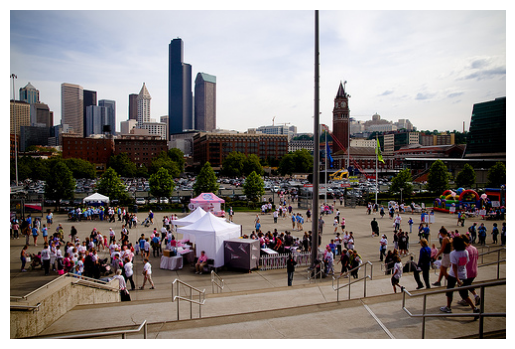

Predicted Caption: a


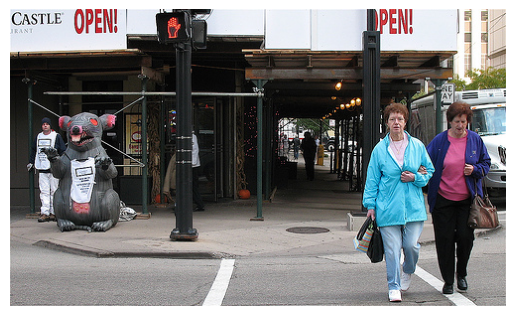

Predicted Caption: a a a a a a a a a a a a a a a a a a a a


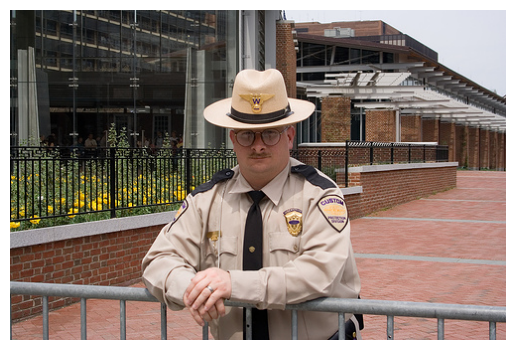

Predicted Caption: a a a a a a a a is a a a a a a a a a a a


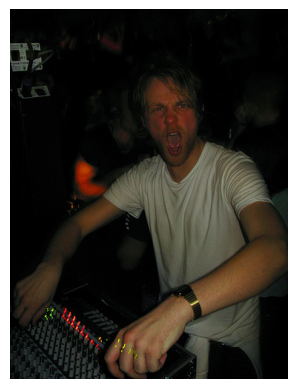

Predicted Caption: a a a a a a a a a a green a a a a a a a


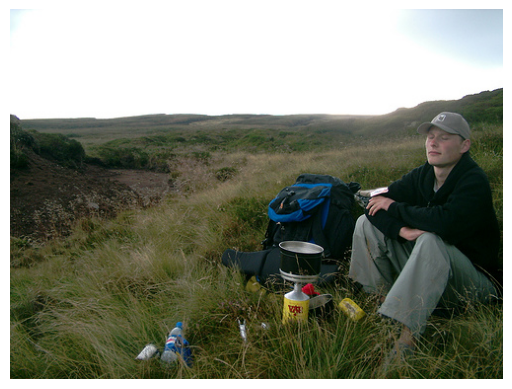

Predicted Caption: a while


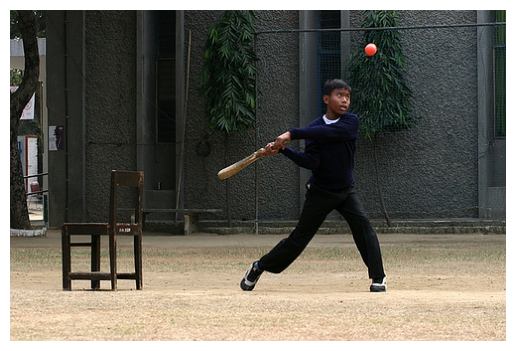

Predicted Caption: a a a a a a a a a a a green a a a a a a a


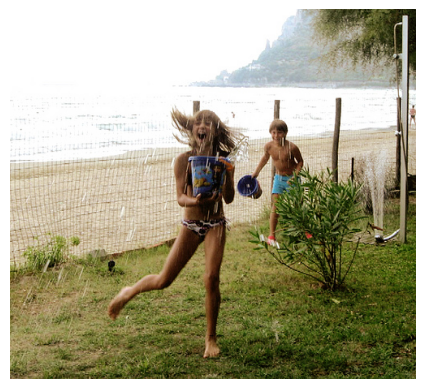

Predicted Caption: 


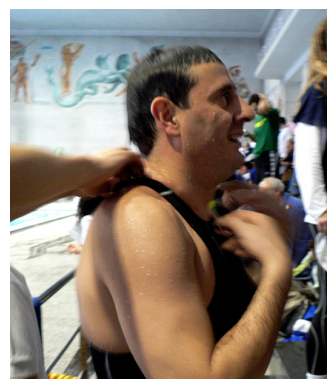

Predicted Caption: is


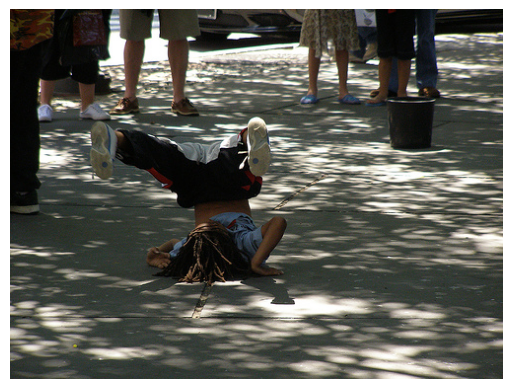

Predicted Caption: a a a a a a a a a a table a a a a a a a


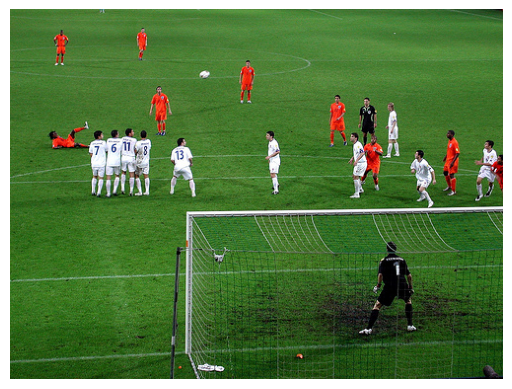

Predicted Caption: a


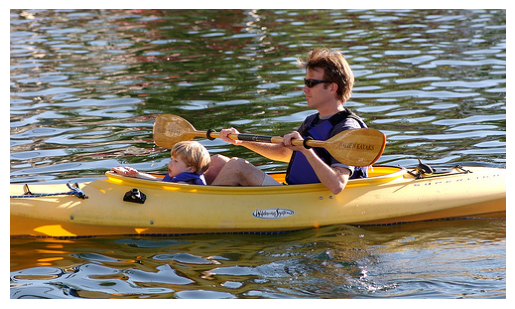

Predicted Caption: is,


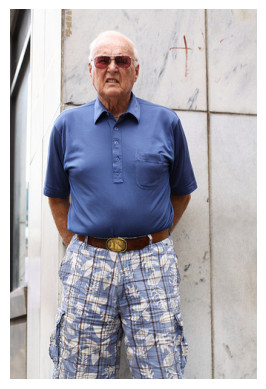

Predicted Caption: a a a a a a a a a a a a a a a a


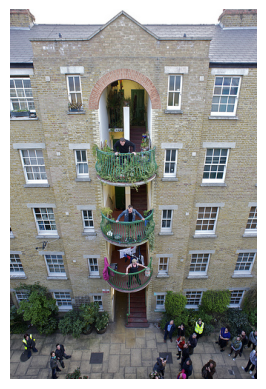

Predicted Caption: green


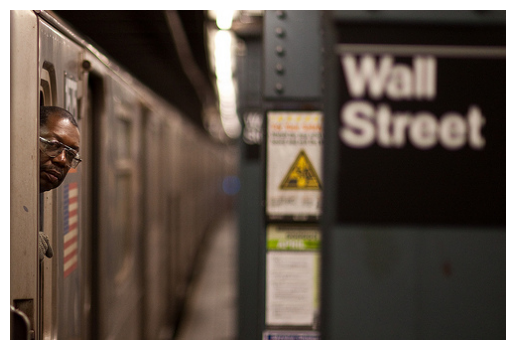

Predicted Caption: a a a a a a a a a a a a a a a a a a a


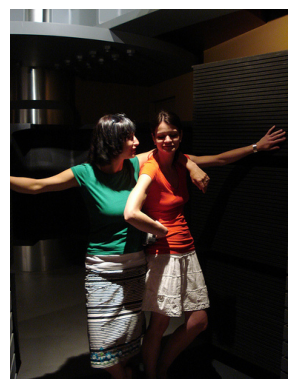

Predicted Caption: a a


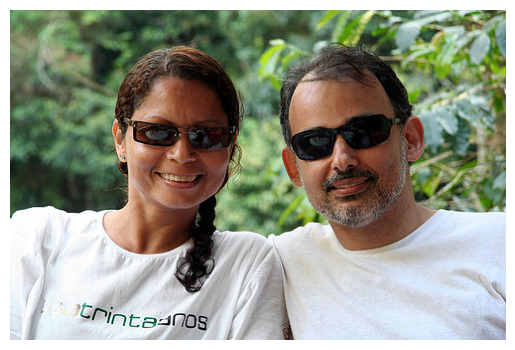

Predicted Caption: a a a a a a a a a a a a a a a a while a a a


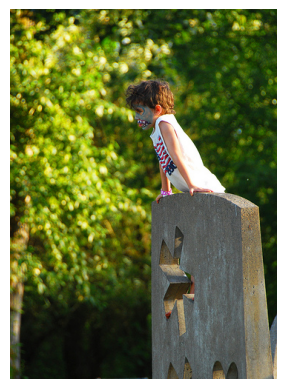

Predicted Caption: a a a a a a a a a a a a a a a a a a a a


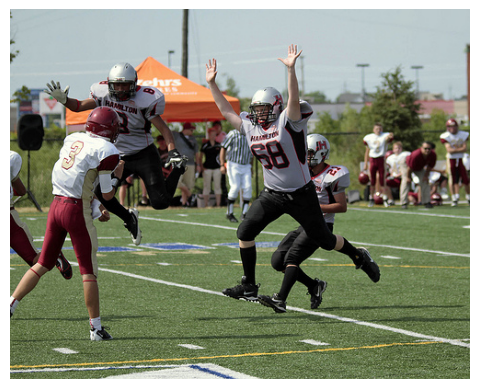

Predicted Caption: a a a a a a a a table a a tram a a a a a a


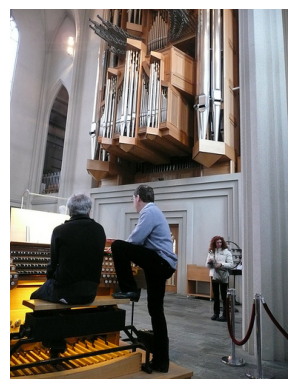

Predicted Caption: a a in


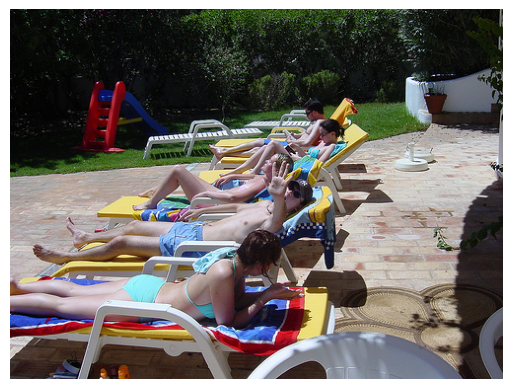

Predicted Caption: a a a a is a a a a a a a a a a a a a a a


In [ ]:
checkpoint_path = "./model_checkpoint/checkpoint_epoch_10.pth"

# Initialize tokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

def predict_from_dataset(model, dataset, image, idx, device, max_length=20):
    """
    Predict the caption for an image from the dataset at a given index.
    Args:
        model: The trained ImageCaption model.
        dataset: The deeplake dataset containing images.
        idx: The index of the image in the dataset.
        device: The device (CPU or GPU) to run the model on.
        max_length: Maximum length of the generated caption.
    Returns:
        The predicted caption as a string.
    """
    # Load and preprocess the image
    # image = dataset.image[idx].numpy()
    # processed_image = process_image(image).unsqueeze(0).to(device)
    image = image.to(device)

    # Start the generation process
    with torch.no_grad():
        # Step 1: Extract image features

        extracted_image = model.feature_extractor_model(image)

        # Step 2: Start with the <START> token
        captions = torch.full(
            (1, 1), tokenizer.convert_tokens_to_ids("<START>"),
            dtype=torch.long, device=device
        )

        # Step 3: Autoregressively generate caption
        for _ in range(max_length):
            # Embed tokens
            token_embeddings = model.embedding(captions)

            # Decode with cross-attention
            token_output = model.decoder_layer((extracted_image, token_embeddings))

            # Post-process to predict the next token
            logits = model.post_processing_model(token_output[:, -1, :])  # Use the last token's output
            next_token = logits.argmax(dim=-1).unsqueeze(1)  # Select the most probable token

            # Append the next token to the captions
            captions = torch.cat([captions, next_token], dim=1)

            # Stop if the <END> token is generated
            if next_token.item() == tokenizer.convert_tokens_to_ids("<END>"):
                break

    # Untokenize the generated tokens
    return untokenize(captions.squeeze(0).tolist())

# Predict for a specific image
for index in range(0, 20):
  plt.imshow(ds.image[index].numpy())
  plt.axis('off')
  plt.show()

  test_image = ds.image[index]
  processed_test_image = process_image(test_image).unsqueeze(0)
  predicted_caption = predict_from_dataset(model, ds, processed_test_image, index, device)
  print(f"Predicted Caption: {predicted_caption}")

# Training Version 2 (New)

In [ ]:
def banned_tokens_to_ids(tokenizer, banned_tokens):
  res = []
  vocab_dict = {name: id for id, name in enumerate(tokenizer.vocab)}
  for token in banned_tokens:
    id = vocab_dict[token]
    res.append(id)
  print (res)
  return res

In [ ]:
banned_token_ids = banned_tokens_to_ids(tokenizer, banned_tokens)

[100, 0, 102, 101, 103, 1996, 1037, 1999]


In [ ]:
import os

os.makedirs("./model_checkpoint", exist_ok=True)

def save_checkpoint(model, optimizer, epoch, path="model_checkpoint.pth"):
    checkpoint = {
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'epoch': epoch + 1  # Save the next epoch to resume correctly
    }
    torch.save(checkpoint, path)
    print(f"Checkpoint saved at {path}")

def train_model(cnn_feature_extraction, embedder, decoder, post_processor, banned_token_ids, data_loader, ratio = 0.5, device="cpu"):
  print (device)
  cnn_feature_extraction.train()
  embedder.train()
  decoder.train()
  post_processor.train()

  for epoch in range(num_epochs):

    total_loss = 0.0

    count = 0
    # run post-processor adapt on all captions
    for image, c in data_loader:
      captions_list = c[0][0].tolist()  # Convert tensor to list
      decoded_captions = [tokenizer.decode(cap) for cap in captions_list]

      if count == 0:
        all_captions = torch.empty(0, dtype=c.dtype, device=c.device)
      count += 1
      all_captions = torch.cat((all_captions, c.flatten()))

    post_processor.adapt(all_captions)

    for images, captions in data_loader:
      images = images.to(device)
      captions = captions.to(device).long()

      batch_size = len(images) # set number of images

      optimizer_cnn.zero_grad()
      optimizer_embedder.zero_grad()
      optimizer_decoder.zero_grad()
      optimizer_post_processor.zero_grad()

      # feature extraction
      features = cnn_feature_extraction(images)  # shape: 1 x 256
      captions = captions.squeeze(1)

      # list to store full outputs
      outputs = []    # shape: length (grows) * 1 * vocab_size

      # store specific word tokens that have been chosen
      token = torch.full((batch_size, 1), tokenizer.cls_token_id).to(device)  # shape: batch * 1
      seq_length = captions.size(1)
      predicted_words = set()
      for t in range(1, seq_length):
        # run embedder, decoder
        post_embed = embedder(token)  # shape: batch * token_length (t) * embed_dim

        output = decoder((features, post_embed))  # shape: batch * token_length * embed_dim

        # select the last word
        output_new = output[:, -1, :]    # shape: batch * 1 * embed_dim

        # run through post processing to get vocab size dimension
        after_post_process_og = post_processor(output_new)    # shape: batch * vocab_size
        after_post_process = after_post_process_og.clone().detach()

        for word in predicted_words:
          after_post_process[:, word] -= 1e9

        outputs.append(after_post_process_og)

        # teacher forcing
        ratio = 0.5 - 0.05 * epoch
        if random.random() < ratio:
          next_word = captions[:, t]
        else:
          next_word = torch.argmax(after_post_process, dim=1)   # gets most likely word

        predicted_words.add(next_word)

        token = torch.cat((token, next_word.unsqueeze(0)), dim=1)   # shape: batch * token_length

        if next_word[0] == tokenizer.sep_token_id:   # if ending word: break
          break

      outputs = torch.stack(outputs, dim=1)  # shape: batch * (seq_length - 1) * vocab_size
      outputs = outputs.reshape(-1, outputs.size(2))   # shape: (seq_length - 1) * vocab_size (or shorter in first dim if early termination)

      caption_original = captions[:, 1:]
      caption_original = caption_original.contiguous().view(-1) # shape: (seq-length - 1)

      # computes loss
      length = outputs.shape[0]
      if length < caption_original.shape[0]:
        caption_original = caption_original[:length]

      mask_banned = torch.isin(caption_original, torch.tensor(banned_token_ids).to(device))

      mask = ~mask_banned

      outputs = outputs[mask]
      caption_original = caption_original[mask]

      loss = criterion(outputs, caption_original)

      loss.backward()
      optimizer_cnn.step()
      optimizer_embedder.step()
      optimizer_decoder.step()
      optimizer_post_processor.step()
      total_loss += loss.item()

    avg_loss = total_loss / len(data_loader)
    print(f"Epoch [{epoch + 1}/{num_epochs}], Loss: {avg_loss:.4f}")

In [ ]:
torch.autograd.set_detect_anomaly(True)

image_caption_model = ImageCaption(tokenizer, vocab_size)

cnn_feature_extraction = image_caption_model.feature_extractor_model
embedder = image_caption_model.embedding
decoder = image_caption_model.decoder_layer
post_processor = image_caption_model.post_processing_model

device = "cuda" if torch.cuda.is_available() else "cpu"
criterion = nn.CrossEntropyLoss()
optimizer_cnn = torch.optim.Adam(cnn_feature_extraction.parameters(), lr=0.001)
optimizer_embedder = torch.optim.Adam(embedder.parameters(), lr=0.001)
optimizer_decoder = torch.optim.Adam(decoder.parameters(), lr=0.001)
optimizer_post_processor = torch.optim.Adam(post_processor.parameters(), lr=0.001)

num_epochs = 10

train_model(cnn_feature_extraction, embedder, decoder, post_processor, banned_token_ids, mini_train_dataloader, device=device)

cuda


100%|██████████| 200/200 [00:00<00:00, 102325.05it/s]


Epoch [1/10], Loss: 10.1029


100%|██████████| 200/200 [00:00<00:00, 34695.21it/s]


Epoch [2/10], Loss: 7.3984


100%|██████████| 200/200 [00:00<00:00, 76308.63it/s]


Epoch [3/10], Loss: 5.5262


100%|██████████| 200/200 [00:00<00:00, 72048.51it/s]


Epoch [4/10], Loss: 4.7560


100%|██████████| 200/200 [00:00<00:00, 75688.97it/s]


Epoch [5/10], Loss: 4.5885


100%|██████████| 200/200 [00:00<00:00, 51363.02it/s]


Epoch [6/10], Loss: 4.6018


100%|██████████| 200/200 [00:00<00:00, 100378.22it/s]


Epoch [7/10], Loss: 4.5232


100%|██████████| 200/200 [00:00<00:00, 131792.74it/s]


Epoch [8/10], Loss: 4.5529


100%|██████████| 200/200 [00:00<00:00, 77236.06it/s]


Epoch [9/10], Loss: 4.5156


100%|██████████| 200/200 [00:00<00:00, 54050.31it/s]


Epoch [10/10], Loss: 4.4454


# Evaluation

In [ ]:
def eval_model(cnn_feature_extraction, embedder, decoder, post_processor, data_loader, ratio = 0.5, device="cpu"):
  cnn_feature_extraction.eval()
  embedder.eval()
  decoder.eval()
  post_processor.eval()

  with torch.no_grad():
    total_loss = 0.0
    count = 0
    # run post-processor adapt on all captions
    for image, c in data_loader:
      captions_list = c[0][0].tolist()  # Convert tensor to list
      decoded_captions = [tokenizer.decode(cap) for cap in captions_list]

      if count == 0:
        all_captions = torch.empty(0, dtype=c.dtype, device=c.device)
      count += 1
      all_captions = torch.cat((all_captions, c.flatten()))

    post_processor.adapt(all_captions)

    for images, captions in data_loader:
      images = images.to(device)
      captions = captions.to(device).long()

      batch_size = len(images) # set number of images

      optimizer_cnn.zero_grad()
      optimizer_embedder.zero_grad()
      optimizer_decoder.zero_grad()
      optimizer_post_processor.zero_grad()

      # feature extraction
      features = cnn_feature_extraction(images)  # shape: 1 x 256
      captions = captions.squeeze(1)

      # list to store full outputs
      outputs = []    # shape: length (grows) * 1 * vocab_size

      # store specific word tokens that have been chosen
      token = torch.full((batch_size, 1), tokenizer.cls_token_id).to(device)  # shape: batch * 1
      seq_length = captions.size(1)
      predicted_words = set()
      for t in range(1, seq_length):
        # run embedder, decoder
        post_embed = embedder(token)  # shape: batch * token_length (t) * embed_dim

        output = decoder((features, post_embed))  # shape: batch * token_length * embed_dim

        # select the last word
        output_new = output[:, -1, :]    # shape: batch * 1 * embed_dim

        # run through post processing to get vocab size dimension
        after_post_process_og = post_processor(output_new)    # shape: batch * vocab_size
        after_post_process = after_post_process_og.clone().detach()

        for word in predicted_words:
          after_post_process[:, word] -= 1e9

        outputs.append(after_post_process_og)

        next_word = torch.argmax(after_post_process, dim=1)   # gets most likely word

        predicted_words.add(next_word)

        token = torch.cat((token, next_word.unsqueeze(0)), dim=1)   # shape: batch * token_length

        if next_word[0] == tokenizer.sep_token_id:   # if ending word: break
          break

      outputs = torch.stack(outputs, dim=1)  # shape: batch * (seq_length - 1) * vocab_size
      outputs = outputs.reshape(-1, outputs.size(2))   # shape: (seq_length - 1) * vocab_size (or shorter in first dim if early termination)

      caption_original = captions[:, 1:]
      caption_original = caption_original.contiguous().view(-1) # shape: (seq-length - 1)

      # computes loss
      length = outputs.shape[0]
      if length < caption_original.shape[0]:
        caption_original = caption_original[:length]

      mask_banned = torch.isin(caption_original, torch.tensor(banned_token_ids).to(device))

      mask = ~mask_banned

      outputs = outputs[mask]
      caption_original = caption_original[mask]

      loss = criterion(outputs, caption_original)
      total_loss += loss.item()

    avg_loss = total_loss / len(data_loader)

    print(f"Validation Loss: {avg_loss:.4f}")
    return avg_loss

In [ ]:
eval_model(cnn_feature_extraction, embedder, decoder, post_processor, mini_train_dataloader, device=device)

100%|██████████| 200/200 [00:00<00:00, 61708.17it/s]


Validation Loss: 4.2634


4.263410258293152

# Prediction

In [ ]:
def predict(cnn_feature_extraction, embedder, decoder, post_processor, image, device='cpu'):
  cnn_feature_extraction.eval()
  embedder.eval()
  decoder.eval()
  post_processor.eval()
  image = image.to(device)

  with torch.no_grad():
      features = cnn_feature_extraction(image)
  batch_size = 1
  max_length = 20

  start_token = torch.full((batch_size, 1), tokenizer.cls_token_id).to(device)

  count = 0
  for image, c in mini_train_dataloader:
    captions_list = c[0][0].tolist()  # Convert tensor to list
    decoded_captions = [tokenizer.decode(cap) for cap in captions_list]

    if count == 0:
      all_captions = torch.empty(0, dtype=c.dtype, device=c.device)
    count += 1
    all_captions = torch.cat((all_captions, c.flatten()))

  post_processor.adapt(all_captions)

  predictions = []
  input = start_token

  predicted_words = set()

  for _ in range(max_length):
      with torch.no_grad():
          post_embed = embedder(input)

          output = decoder((features, post_embed))

          output_new = output[:, -1, :]

          after_post_process = post_processor(output_new)    # shape: batch * embed_dim

          for word in predicted_words:
              after_post_process[:, word] -= 1e9

          next_word = torch.argmax(after_post_process, dim=1)   # gets most likely word

          predicted_words.add(next_word)

          last_predicted_word = next_word

          input = torch.cat((input, next_word.unsqueeze(0)), dim=1)   # shape: batch * token_length

          predictions.append(next_word.item())

          # if predict a </e> end token, Exit
          if next_word[0] == tokenizer.sep_token_id:
              break

  predictions = untokenize(predictions)
  return predictions

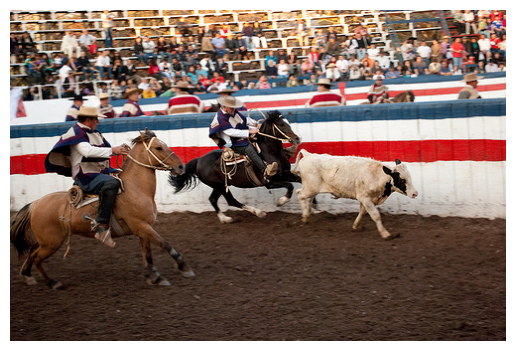

100%|██████████| 200/200 [00:00<00:00, 72697.88it/s]


Predicted Caption: . is on to woman shirt blond blue man and while her rail, wearing girl pants looking over brown


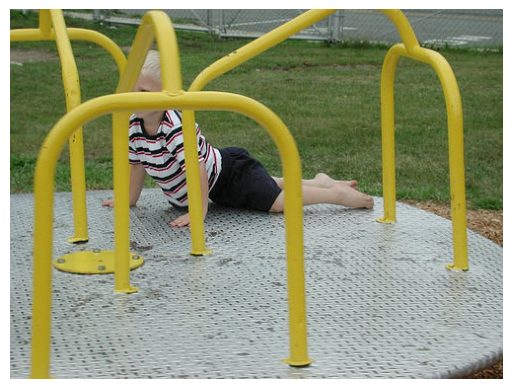

100%|██████████| 200/200 [00:00<00:00, 76087.15it/s]


Predicted Caption: is on. shirt blue to and woman while blond man, her pants girl wearing cavaliers at with rail


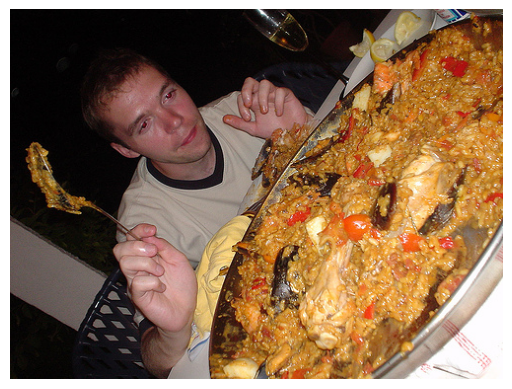

100%|██████████| 200/200 [00:00<00:00, 60541.34it/s]


Predicted Caption: is. on shirt blue to woman and blond while man, her pants girl wearing at rail over with


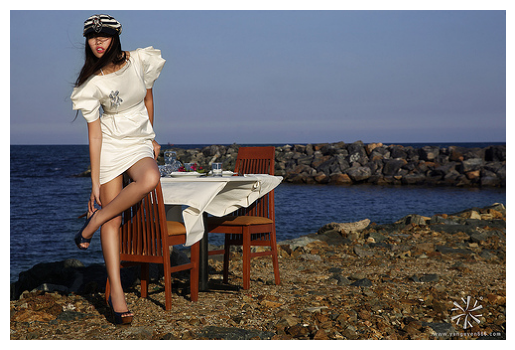

100%|██████████| 200/200 [00:00<00:00, 53247.48it/s]


Predicted Caption: . is blond woman on to shirt blue man and while rail her over looking poking girl, wearing at


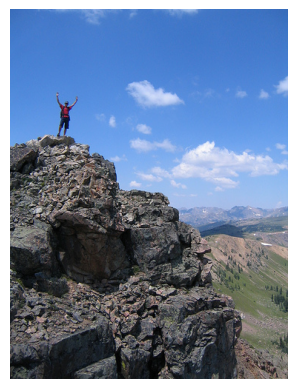

100%|██████████| 200/200 [00:00<00:00, 68979.59it/s]


Predicted Caption: is. on to woman blond shirt blue man and while her rail wearing, girl looking pants over poking


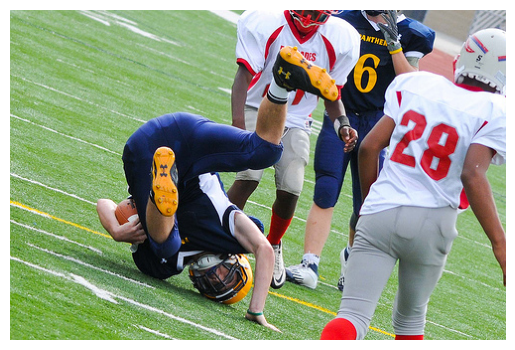

100%|██████████| 200/200 [00:00<00:00, 58469.42it/s]


Predicted Caption: is. on to shirt woman blue man blond while and wearing her girl rail, pants looking an brown


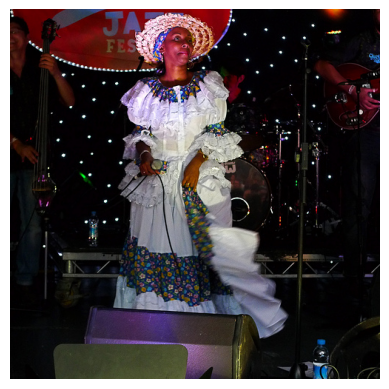

100%|██████████| 200/200 [00:00<00:00, 51297.06it/s]


Predicted Caption: is. on to shirt blue woman man blond and while wearing, her girl pants rail brown an looking


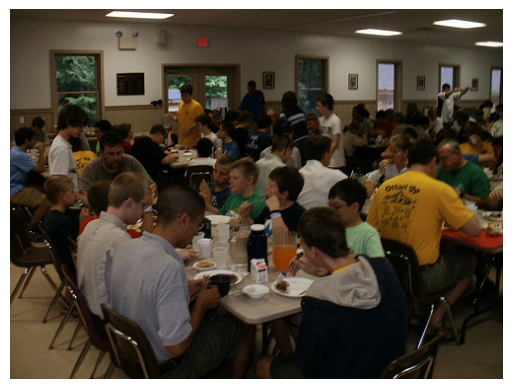

100%|██████████| 200/200 [00:00<00:00, 70156.46it/s]


Predicted Caption: is. on woman to shirt blond blue and man while her rail, girl wearing pants looking over at


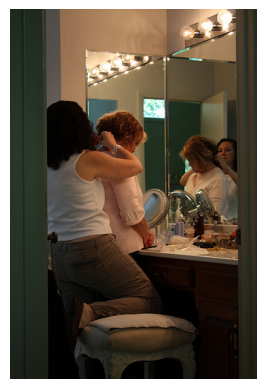

100%|██████████| 200/200 [00:00<00:00, 62156.25it/s]


Predicted Caption: . is on woman blond to shirt blue man while and rail her looking over wearing girl, poking pants


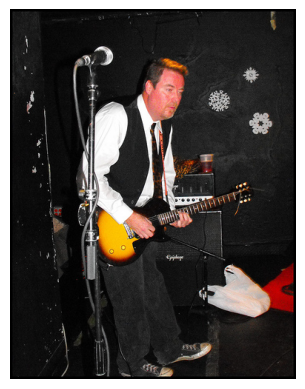

100%|██████████| 200/200 [00:00<00:00, 47954.08it/s]


Predicted Caption: . is on woman to shirt blond blue and man while her, rail girl pants wearing over looking at


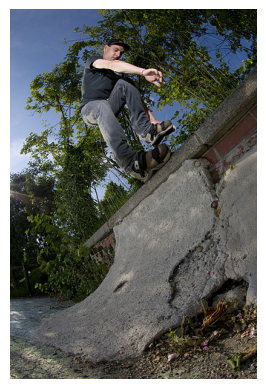

100%|██████████| 200/200 [00:00<00:00, 69800.37it/s]


Predicted Caption: is. on to shirt blue woman man blond and while wearing her, girl pants rail an brown looking


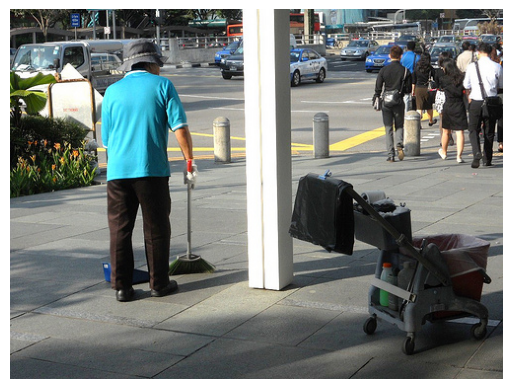

100%|██████████| 200/200 [00:00<00:00, 72925.39it/s]


Predicted Caption: is. to on woman shirt man blond blue while wearing rail and her looking, girl pants an brown


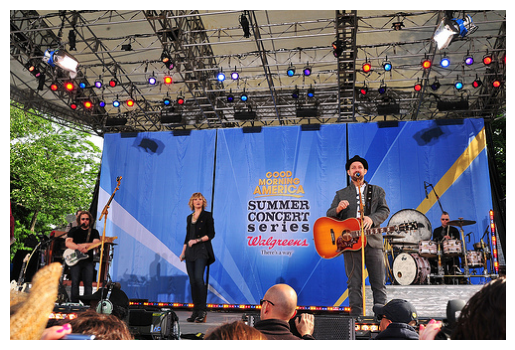

100%|██████████| 200/200 [00:00<00:00, 77932.07it/s]


Predicted Caption: is. on shirt to blue woman blond and man while, her wearing girl pants rail looking brown at


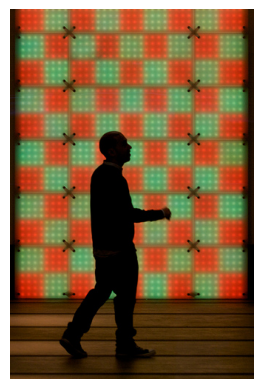

100%|██████████| 200/200 [00:00<00:00, 67481.36it/s]


Predicted Caption: . is on woman blond shirt to blue man and while rail her over, looking pants girl wearing poking


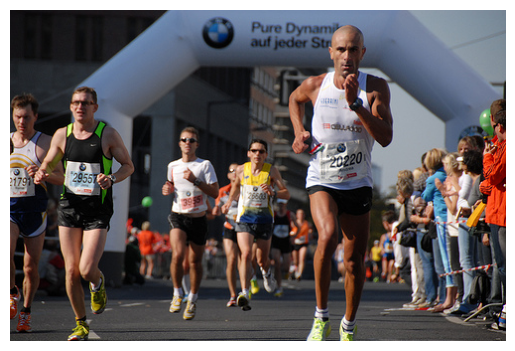

100%|██████████| 200/200 [00:00<00:00, 55359.39it/s]


Predicted Caption: . is on woman shirt to blond blue and man while her, rail girl pants over wearing looking at


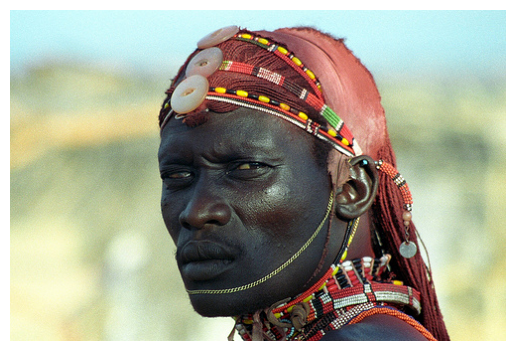

100%|██████████| 200/200 [00:00<00:00, 76357.25it/s]


Predicted Caption: is. on to shirt blue woman man blond while wearing her and girl rail looking, an pants brown


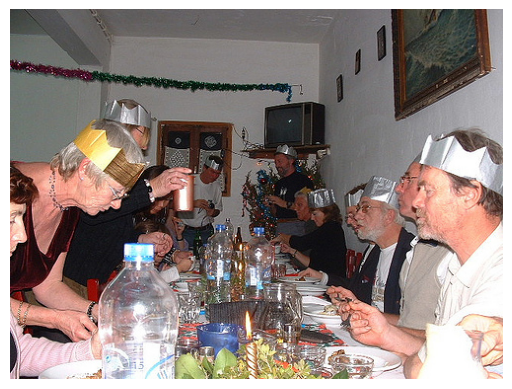

100%|██████████| 200/200 [00:00<00:00, 76454.68it/s]


Predicted Caption: on is. shirt blue to and woman while man blond, wearing pants girl her at brown an with


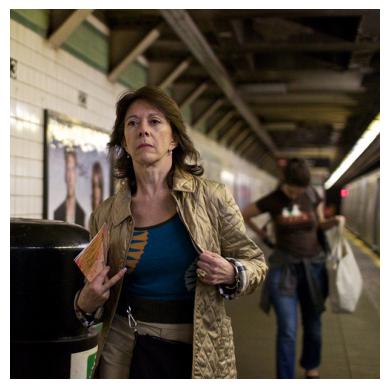

100%|██████████| 200/200 [00:00<00:00, 70837.76it/s]


Predicted Caption: is. on to shirt woman blue blond man and while her wearing, girl rail pants looking brown an


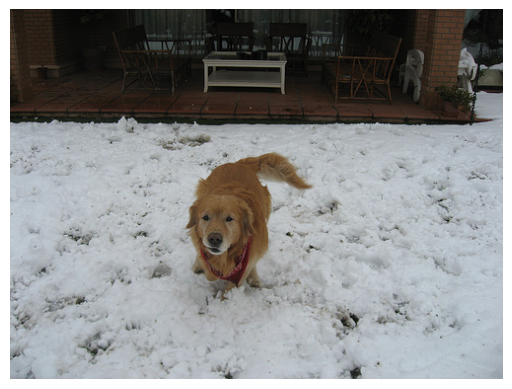

100%|██████████| 200/200 [00:00<00:00, 50165.10it/s]


Predicted Caption: on is. shirt blue to and woman man while blond, wearing pants girl her brown an with cavaliers


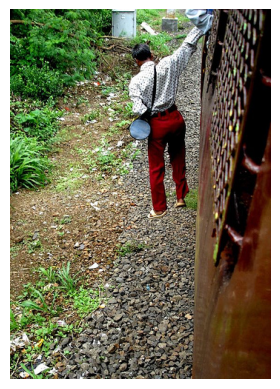

100%|██████████| 200/200 [00:00<00:00, 53680.22it/s]

Predicted Caption: is. on to shirt woman blue blond man while and wearing her, girl rail pants looking an brown


In [ ]:
# Predict for a range of images
for index in range(100, 120):
  plt.imshow(ds.image[index].numpy())
  plt.axis('off')
  plt.show()

  test_image = ds.image[index]
  processed_test_image = process_image(test_image).unsqueeze(0)
  predicted_caption = predict(cnn_feature_extraction, embedder, decoder, post_processor, processed_test_image, device)
  print(f"Predicted Caption: {predicted_caption}")

# **Testing**

In [ ]:
!pip install tqdm
!pip install torch torchvision Pillow numpy tqdm

In [ ]:
import unittest
from torch.utils.data import DataLoader
from torchvision import transforms
from PIL import Image
import numpy as np
import collections

Image Captioning

In [ ]:
class TestImageCaptioningComponents(unittest.TestCase):
    def setUp(self):
        self.vocab_size = 1000
        self.max_length = 20
        self.embed_dim = 256
        self.num_heads = 1
        self.dropout = 0.1
        self.device = "cuda" if torch.cuda.is_available() else "cpu"

        # initialize using our classes
        self.embedding = Embedding(self.vocab_size, self.max_length, self.embed_dim).to(self.device)
        self.self_attention = SelfAttention(self.num_heads, self.embed_dim, self.dropout).to(self.device)
        self.cross_attention = CrossAttention(self.embed_dim, self.num_heads, self.dropout).to(self.device)
        self.feed_forward = FeedForward(self.embed_dim, self.dropout).to(self.device)

    # test for Embedding()
    def test_embedding_output_dim(self):
        caption = torch.randint(0, self.vocab_size, (1, self.max_length)).to(self.device)
        output = self.embedding(caption)
        self.assertEqual(output.shape, (1, self.max_length, self.embed_dim), "Embedding output dimensions are incorrect")

    # test for SelfAttention()
    def test_selfattention_output_dim(self):
        input_tensor = torch.rand(1, self.max_length, self.embed_dim).to(self.device)
        output = self.self_attention(input_tensor)
        self.assertEqual(output.shape, input_tensor.shape, "Self Attention output dimensions are incorrect")

    # test for CrossAttention()
    def test_crossattention_output_dim(self):
        caption_embedding = torch.rand(1, self.max_length, self.embed_dim).to(self.device)
        image_features = torch.rand(1, self.embed_dim).to(self.device)
        output=self.cross_attention(caption_embedding, image_features)
        self.assertEqual(output.shape, caption_embedding.shape, "Cross Attention output dimensions are incorrect")

    # test FeedForward()
    def test_feedforward_output_dim(self):
        input_tensor = torch.rand(1, self.max_length, self.embed_dim).to(self.device)
        output = self.feed_forward(input_tensor)
        self.assertEqual(output.shape, input_tensor.shape, "Feed Forward output dimensions are incorrect")

# Running the tests in the notebook
def run_tests():
    test_loader = unittest.TestLoader()
    test_suite = test_loader.loadTestsFromTestCase(TestImageCaptioningComponents)
    test_runner = unittest.TextTestRunner(verbosity=2)
    test_results = test_runner.run(test_suite)
    print(test_results)

In [ ]:
run_tests()

test_crossattention_output_dim (__main__.TestImageCaptioningComponents) ... ok
test_embedding_output_dim (__main__.TestImageCaptioningComponents) ... ok
test_feedforward_output_dim (__main__.TestImageCaptioningComponents) ... ok
test_selfattention_output_dim (__main__.TestImageCaptioningComponents) ... ok

----------------------------------------------------------------------
Ran 4 tests in 0.118s

OK


<unittest.runner.TextTestResult run=4 errors=0 failures=0>


Test PostProcessing

In [ ]:
class MockTokenizer:
    def __init__(self, base_vocab_size):
        self.base_vocab_size = base_vocab_size
        self.banned_tokens = ['[UNK]', '[PAD]', '[SEP]', '[CLS]', '[MASK]', 'the', 'a', 'in']
        self.vocab = {str(i): i for i in range(base_vocab_size)}
        self.vocab.update({token: base_vocab_size + i for i, token in enumerate(self.banned_tokens)})

    @property
    def vocab_size(self):
        # This should return the total size including the banned tokens
        return self.base_vocab_size + len(self.banned_tokens)

    def banned_tokens_ids(self):
        return [self.vocab[token] for token in self.banned_tokens]

In [ ]:
class TestPostProcessing(unittest.TestCase):
    def setUp(self):
        self.embed_dim = 256
        self.base_vocab_size = 1000  # Base vocabulary size excluding banned tokens
        self.tokenizer = MockTokenizer(self.base_vocab_size)
        self.device = "cuda" if torch.cuda.is_available() else "cpu"
        self.banned_tokens = self.tokenizer.banned_tokens
        self.post_processing = PostProcessing(self.embed_dim, self.tokenizer, self.banned_tokens).to(self.device)

    def test_initial_bias(self):
        """Test that initial bias is None."""
        self.assertIsNone(self.post_processing.bias, "Initial bias should be None.")

    def test_adapt_bias_modification(self):
        """ Test the bias computation and adaptation """
        dataset = [torch.tensor([1, 2, 3, 4, 0, 1, 2, 3, 4, 0]) for _ in range(10)]
        self.post_processing.adapt(dataset)

        banned_indices = [self.tokenizer.vocab.get(token, -1) for token in self.banned_tokens]
        banned_biases = {token: self.post_processing.bias[idx].item() for token, idx in zip(self.banned_tokens, banned_indices)}
        print("Banned biases:", banned_biases)

        self.assertTrue(all(self.post_processing.bias[1:5] < 0), "Regular token biases should be calculated and less negative.")

        for idx in banned_indices:
            self.assertTrue(self.post_processing.bias[idx] <= -1e6, f"Bias for banned token should be extremely negative.")

    def test_forward_output(self):
        """Test the forward pass output dimensions and values after bias has been set."""
        if self.post_processing.bias is None:
            dataset = [torch.tensor([1, 2, 3, 4, 0, 1, 2, 3, 4, 0]) for _ in range(10)]
            self.post_processing.adapt(dataset)

        input_tensor = torch.randn(1, 20, self.embed_dim).to(self.device)
        self.post_processing.bias = self.post_processing.bias.to(input_tensor.device)

        output = self.post_processing(input_tensor)
        self.assertEqual(output.shape, (1, 20, self.base_vocab_size + len(self.banned_tokens)), "Output dimensions should match (batch, sequence length, vocab size).")

In [ ]:
def run_tests_postprocessing():
    test_loader = unittest.TestLoader()
    test_suite = test_loader.loadTestsFromTestCase(TestPostProcessing)
    test_runner = unittest.TextTestRunner(verbosity=2)
    test_results = test_runner.run(test_suite)
    print(test_results)

run_tests_postprocessing()

test_adapt_bias_modification (__main__.TestPostProcessing)
100%|██████████| 10/10 [00:00<00:00, 4814.95it/s]
ok
test_forward_output (__main__.TestPostProcessing)
Test the forward pass output dimensions and values after bias has been set. ... 

Banned biases: {'[UNK]': -1000000000.0, '[PAD]': -1000000000.0, '[SEP]': -1000000000.0, '[CLS]': -1000000000.0, '[MASK]': -1000000000.0, 'the': -1000000000.0, 'a': -1000000000.0, 'in': -1000000000.0}


100%|██████████| 10/10 [00:00<00:00, 16448.25it/s]
ok
test_initial_bias (__main__.TestPostProcessing)
Test that initial bias is None. ... ok

----------------------------------------------------------------------
Ran 3 tests in 0.105s

OK


<unittest.runner.TextTestResult run=3 errors=0 failures=0>


In [ ]:
class MockTokenizer_cap:
    def __init__(self):
        # Create a vocabulary that the PostProcessing class can use to map names to IDs
        self.vocab = {str(i): i for i in range(100)}  # Example vocabulary with 100 tokens
        self.banned_tokens = ['[UNK]', '[PAD]', '[SEP]', '[CLS]', '[MASK]', 'the', 'a', 'in']
        self.vocab = {**self.vocab, **{token: 100 + i for i, token in enumerate(self.banned_tokens)}}


    def encode(self, text):
        # Simulate encoding text into a sequence of token IDs
        return [self.vocab[str(i)] for i in range(len(text.split()))]

    def decode(self, tokens):
        # Simulate decoding a sequence of token IDs back into text
        return ' '.join(str(token) for token in tokens)

    @property
    def vocab_size(self):
        return len(self.vocab)


In [ ]:
class TestImageCaption(unittest.TestCase):
    def setUp(self):
        self.tokenizer = MockTokenizer_cap()
        self.model = ImageCaption(
            self.tokenizer, vocab_size=100, num_layers=1, embed_dim=256, max_length=20, num_heads=2, dropout=0.1
        )
        self.model.eval()
        mock_captions = torch.randint(0, 100, (100, 20))
        self.model.post_processing_model.adapt(mock_captions)


    def test_initialization(self):
        """ Test if the model initializes without errors """
        self.assertIsInstance(self.model, ImageCaption)



    def test_component_interaction(self):
        """ Test interactions between components within the model """
        dummy_image = torch.rand(1, 3, 224, 224).to(device)
        dummy_caption = "another test caption"
        tokens = torch.tensor([self.tokenizer.encode(dummy_caption)]).to(device)

        # Forward pass
        image_features = self.model.feature_extractor_model(dummy_image)
        token_embeddings = self.model.embedding(tokens)
        decoded_output = self.model.decoder_layer((image_features, token_embeddings))
        final_output = self.model.post_processing_model(decoded_output)

        self.assertTrue(torch.is_tensor(image_features))
        self.assertTrue(torch.is_tensor(token_embeddings))
        self.assertTrue(torch.is_tensor(decoded_output))
        self.assertTrue(torch.is_tensor(final_output))

    def test_error_handling(self):
        """ Test the model's error handling for incorrect inputs """
        with self.assertRaises(Exception):
            self.model((torch.rand(5, 5), "wrong input type for caption"))

In [ ]:
def run_tests_caption():
    test_loader = unittest.TestLoader()
    test_suite = test_loader.loadTestsFromTestCase(TestImageCaption)
    test_runner = unittest.TextTestRunner(verbosity=2)
    test_results = test_runner.run(test_suite)
    print(test_results)

run_tests_caption()

test_component_interaction (__main__.TestImageCaption)
100%|██████████| 100/100 [00:00<00:00, 15003.77it/s]
ok
test_error_handling (__main__.TestImageCaption)
100%|██████████| 100/100 [00:00<00:00, 24598.58it/s]
ok
test_initialization (__main__.TestImageCaption)
100%|██████████| 100/100 [00:00<00:00, 36500.77it/s]
ok

----------------------------------------------------------------------
Ran 3 tests in 6.593s

OK


<unittest.runner.TextTestResult run=3 errors=0 failures=0>


## Random Guessing Model (Post Demo 2)

In [ ]:
def random_predict(data_loader, device='cpu'):
  """
  Selects random caption from the training set. Used as a benchmark for our model

  Parameters
  data_loader: where to load training images/captions from
  device: device to run on
  """
  caption_list = []
  for _, captions in data_loader:
    captions_list = captions[0][0].tolist()  # Convert tensor to list
    decoded_captions = [tokenizer.decode(cap) for cap in captions_list]
    caption_list.append(decoded_captions)
  selected = random.choice(caption_list)
  ending = selected.index('[SEP]')
  return ' '.join(selected[1:ending])


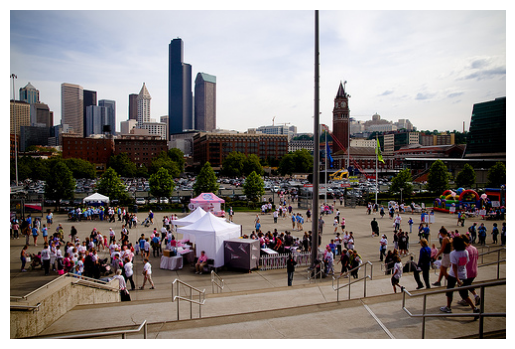

Actual Caption: Crowds of people are walking are multicolored tents and flags that are put up outside in a cement lot as a big city looms in the distance .
Predicted Caption: a man on horseback in a rodeo arena is trying to lass ##o a black calf .


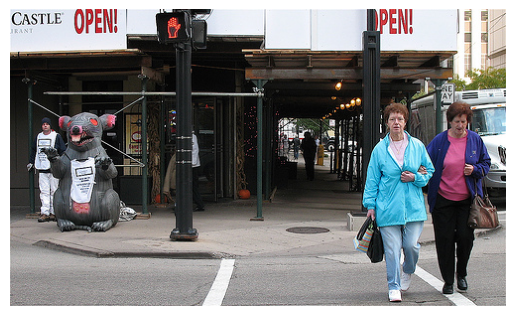

Actual Caption: Two women in a light blue and a dark blue jacket walking in a crosswalk and a fake giant rat is on the sidewalk behind them .
Predicted Caption: a group of woman from various ethnic backgrounds are competing in a marathon .


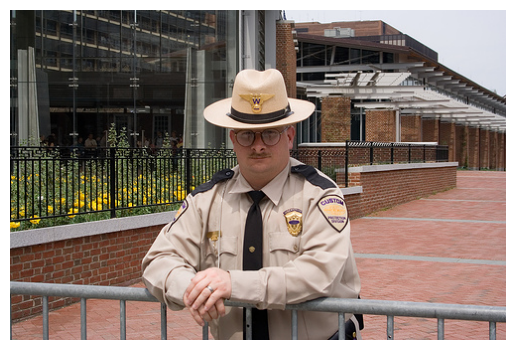

Actual Caption: A security officer with a tiny face and big glasses leans on a metal gate looking into the camera .
Predicted Caption: a man prepares food at an outdoor event before a table spread with multiple fresh vegetables .


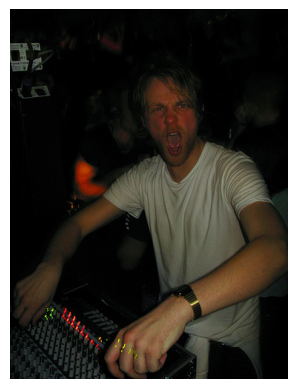

Actual Caption: A man with a white shirt with his mouth open wide and turning buttons .
Predicted Caption: a man on horseback in a rodeo arena is trying to lass ##o a black calf .


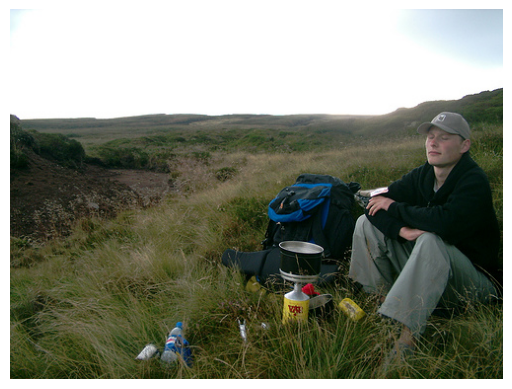

Actual Caption: A man enjoys a peaceful solitary moment while camping .
Predicted Caption: a group of woman from various ethnic backgrounds are competing in a marathon .


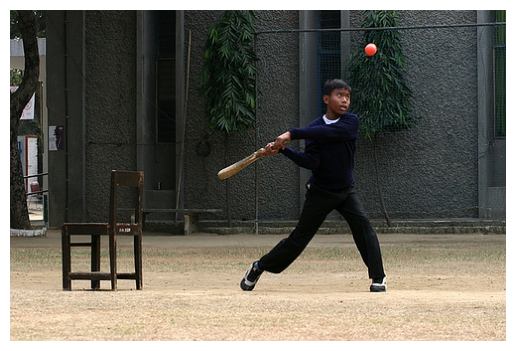

Actual Caption: A young Indian male is hitting a red ball with a bat next to a brown chair .
Predicted Caption: a group of woman from various ethnic backgrounds are competing in a marathon .


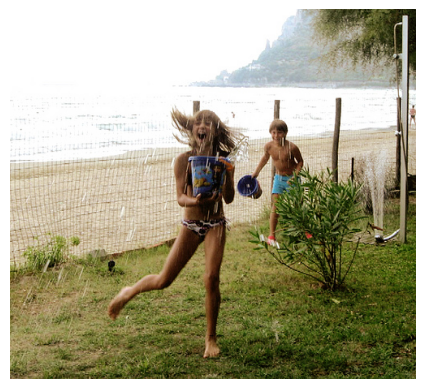

Actual Caption: A young girl and young boy are playing with pails of water with the ocean in the background .
Predicted Caption: a motor ##cy ##cl ##ist wearing full protective gear on a green bike is about to descend a


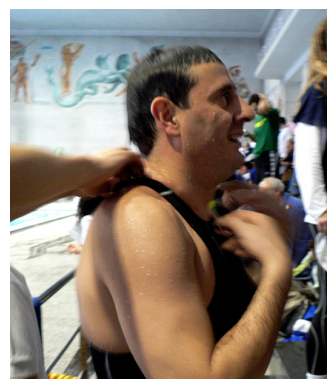

Actual Caption: A man with brown hair is all wet wearing a black shirt that someone is helping him with .
Predicted Caption: a man on horseback in a rodeo arena is trying to lass ##o a black calf .


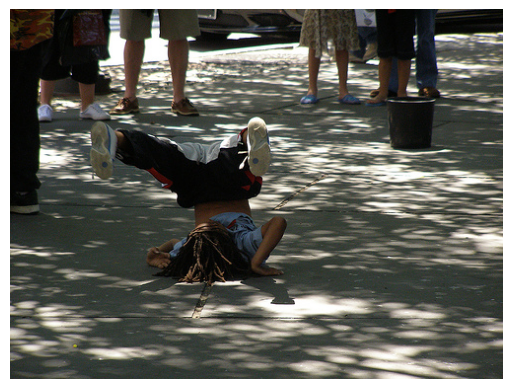

Actual Caption: Man breakdancing while trying to push himself off the ground , while his legs are in the air and hands and head on the floor .
Predicted Caption: a young girl in a striped shirt and blue pants falls onto a tram ##pol ##ine while on


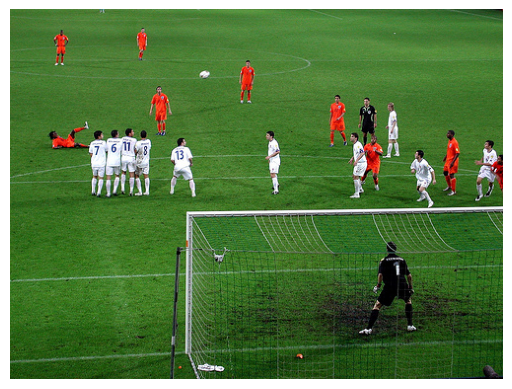

Actual Caption: Men dressed in red and men dressed in white are playing a game of soccer .
Predicted Caption: a man on horseback in a rodeo arena is trying to lass ##o a black calf .


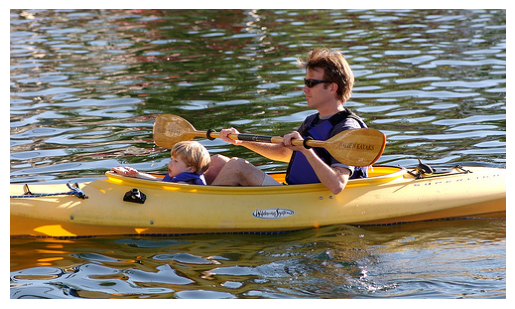

Actual Caption: A man and a little boy in blue life jackets are rowing a yellow canoe .
Predicted Caption: a group of woman from various ethnic backgrounds are competing in a marathon .


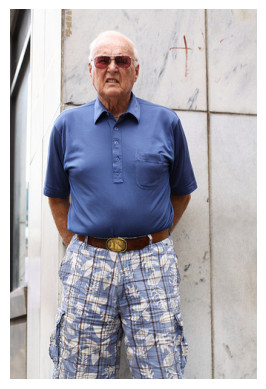

Actual Caption: Senior citizen with blue shirt and blue pants standing outdoors with hands behind his back .
Predicted Caption: a young girl in a striped shirt and blue pants falls onto a tram ##pol ##ine while on


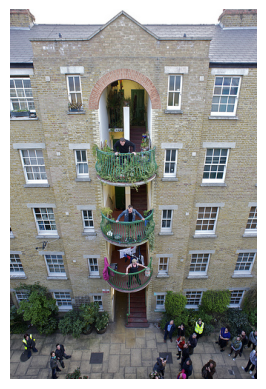

Actual Caption: a large house with three stories and 3 matching balconies , with one person standing on each balcony overlooking onlookers .
Predicted Caption: a man on horseback in a rodeo arena is trying to lass ##o a black calf .


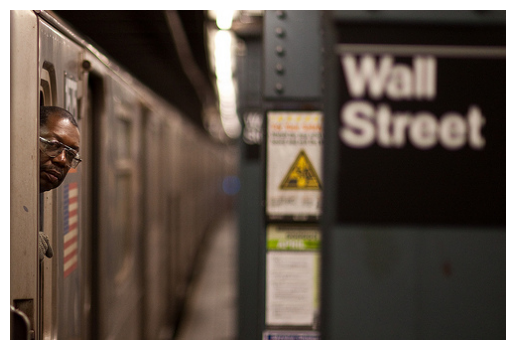

Actual Caption: An elderly American male looking before he steps outside of a subway train .
Predicted Caption: a man prepares food at an outdoor event before a table spread with multiple fresh vegetables .


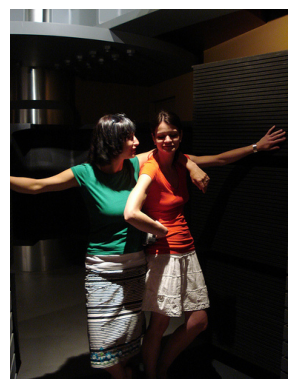

Actual Caption: A woman in a skirt and green t-shirt has her arm draped over the shoulder of a younger woman in a white skirt and orange t-shirt .
Predicted Caption: blond woman looking down over a wooden rail .


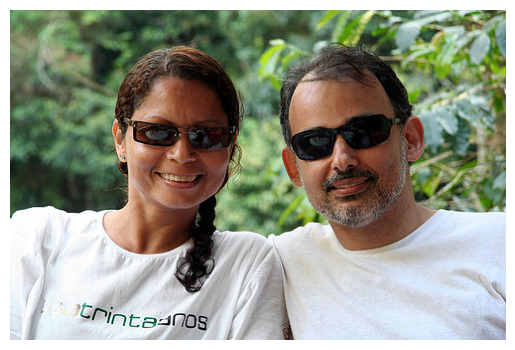

Actual Caption: A man and woman wearing sunglasses and white t-shirts smile for the camera .
Predicted Caption: a small blond boy dressed in shorts and a blue shirt playing on a jungle gym .


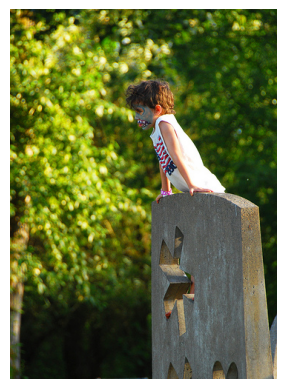

Actual Caption: This stone sculptor gently shaded seems to decorate a garden but here a young boy dressed in a US flag decorated t-shirt enjoys climbing on it .
Predicted Caption: an elderly man with light brown hair , wearing a gray sweater , blue shirt , brown pants


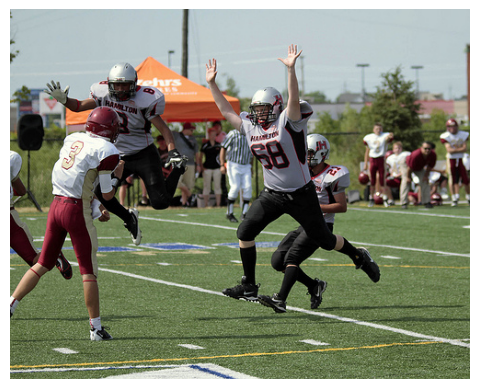

Actual Caption: Two football players leap into the air as a player on the opposing team moves toward them .
Predicted Caption: a man on horseback in a rodeo arena is trying to lass ##o a black calf .


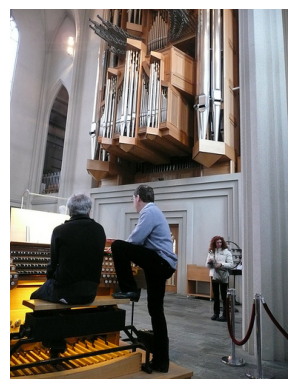

Actual Caption: There are two men and a woman in church , the woman is in the back and the men are next to a piano .
Predicted Caption: a young girl in a striped shirt and blue pants falls onto a tram ##pol ##ine while on


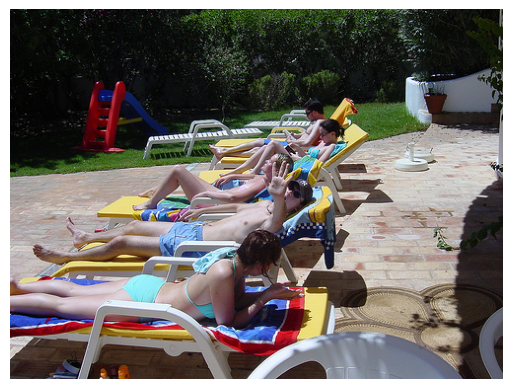

Actual Caption: Five people are laying on beach chairs while one man is raising his hand to the camera .
Predicted Caption: a group of woman from various ethnic backgrounds are competing in a marathon .


In [ ]:
# Testing random captioning on sone indices
for index in range(0, 20):
  plt.imshow(ds.image[index].numpy())
  plt.axis('off')
  plt.show()

  test_image = ds.image[index]
  actual_caption = ds.caption_0[index].numpy()[0]
  print(f"Actual Caption: {actual_caption}")
  processed_test_image = process_image(test_image).unsqueeze(0)
  predicted_caption = random_predict(mini_train_dataloader)
  print(f"Predicted Caption: {predicted_caption}")

# Evaluation (Post Demo 2)

Bleu Score

In [ ]:
from nltk.translate.bleu_score import sentence_bleu, SmoothingFunction

def compute_bleu(index, caption):
  """
  Computes bleu evaluation score for an image caption at a given index,
  where 0 is worst and 1 is best

  Parameters:
  index - index of flickr dataset to evaluate (where to find image, true captions)
  caption - caption to evaluate, either from our model or random guessing model

  Returns:
  score - bleu score, float
  """

  # gets image, captions
  test_image = ds.image[index]
  caption_0 = ds.caption_0[index].numpy()[0].split()
  caption_1 = ds.caption_1[index].numpy()[0].split()
  caption_2 = ds.caption_2[index].numpy()[0].split()
  caption_3 = ds.caption_3[index].numpy()[0].split()
  caption_4 = ds.caption_4[index].numpy()[0].split()

  predicted_caption = caption.split()

  # computes bleu score
  smoothie = SmoothingFunction().method4
  score = sentence_bleu([caption_0, caption_1, caption_2, caption_3, caption_4],
                        predicted_caption, smoothing_function = smoothie)
  return score



CIDEr Score

In [ ]:
!pip install pycocoevalcap

In [ ]:
# from torchmetrics.text.cider import CIDER
from pycocoevalcap.cider.cider import Cider

def compute_cider(start_index, end_index, caption):
  """
  Computes average cider evaluation score for multiple image captions in range
  [start_index, end_index), returns average

  Parameters:
  start_index - starting index of flickr dataset to evaluate (where to find image, true captions)
  end_index - ending index of flickr dataset to evaluate (not inclusive)
  caption - the list of captions to evaluate, either from our model or random guessing model

  Returns:
  score - cider score, float
  """
  # gets image, captions for all indices in range
  refs = {}
  hyps = {}
  count = 0
  for index in range(start_index, end_index+1):
    refs[index] = [ds.caption_0[index].numpy()[0], ds.caption_1[index].numpy()[0], ds.caption_2[index].numpy()[0],
             ds.caption_3[index].numpy()[0], ds.caption_4[index].numpy()[0]]
    hyps[index] = [caption[count]]
    count += 1

  # computes cider score
  cider_scorer = Cider()
  score = cider_scorer.compute_score(refs, hyps)
  return score[0]

## Benchmarking Random with Bleu/Cider Scores

In [ ]:
def benchmark_bleu(start, end, data_loader, USE_RANDOM):
  """
  Benchmarks bleu score for our image captioning model. Using either random captions
  or generates from our model, then computes bleu scores from indices start...end.
  Returns the average of these scores.

  Parameters:
  start - starting index of flickr dataset to evaluate (where to find image, true captions)
  end - ending index of flickr dataset to evaluate (not inclusive)
  data_loader - where to load training images/captions from
  USE_RANDOM - if True, use random captions. If False, use our model
  """
  scores = []
  for i in range(start, end+1):
    if USE_RANDOM:
      caption = random_predict(data_loader)
    else:
      test_image = ds.image[index]
      processed_test_image = process_image(test_image).unsqueeze(0)
      caption = predict(cnn_feature_extraction, embedder, decoder, post_processor, processed_test_image, device)
    scores.append(compute_bleu(index, caption))
  return np.mean(scores)


In [ ]:
def benchmark_cider(start, end, data_loader, USE_RANDOM):
  """
  Benchmarks cider score for our image captioning model. Using either random captions
  or generates from our model, then computes cider scores from indices start...end.
  Returns the average of these scores.

  Parameters:
  start - starting index of flickr dataset to evaluate (where to find image, true captions)
  end - ending index of flickr dataset to evaluate (not inclusive)
  data_loader - where to load training images/captions from
  USE_RANDOM - if True, use random captions. If False, use our model
  """
  all_captions = []
  for i in range(start, end+1):
    if USE_RANDOM:
      caption = random_predict(data_loader)
    else:
      test_image = ds.image[index]
      processed_test_image = process_image(test_image).unsqueeze(0)
      caption = predict(cnn_feature_extraction, embedder, decoder, post_processor, processed_test_image, device)
    all_captions.append(caption)
  return compute_cider(start, end,all_captions)


In [ ]:
start = 80
end = 100
bleu_score_random = benchmark_bleu(start, end, mini_train_dataloader, True)
print (f"On {end - start} Images, Avergae BLEU Score of Random Guessing Model: {bleu_score_random}")

On 20 Images, Avergae BLEU Score of Random Guessing Model: 0.019983352968220753


In [ ]:
start = 80
end = 100
bleu_score_random = benchmark_bleu(start, end, mini_train_dataloader, False)
print (f"On {end - start} Images, Avergae BLEU Score of Our Model: {bleu_score_random}")

100%|██████████| 200/200 [00:00<00:00, 62897.26it/s]

On 20 Images, Avergae BLEU Score of Our Model: 0.02013606538756309


In [ ]:
start = 80
end = 100
cider_score_random = benchmark_cider(start, end, mini_train_dataloader, True)
print (f"On {end - start} Images, Avergae CIDEr Score of Random Guessing Model: {cider_score_random}")

On 20 Images, Avergae CIDEr Score of Random Guessing Model: 0.028257937910532036


In [ ]:
start = 80
end = 100
cider_score_random = benchmark_cider(start, end, mini_train_dataloader, False)
print (f"On {end - start} Images, Avergae CIDEr Score of Our Model: {cider_score_random}")

100%|██████████| 200/200 [00:00<00:00, 43414.80it/s]


On 20 Images, Avergae CIDEr Score of Our Model: 0.051873923198644784
